In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
# Image completion
import os
if os.path.exists('dog.jpg'):
    print('dog.jpg exists')
else:
    !wget https://segment-anything.com/assets/gallery/AdobeStock_94274587_welsh_corgi_pembroke_CD.jpg -O dog.jpg

dog.jpg exists


In [3]:
# Read in a image from torchvision
import torchvision
img = torchvision.io.read_image("dog.jpg")
print(img.shape)

torch.Size([3, 1365, 2048])


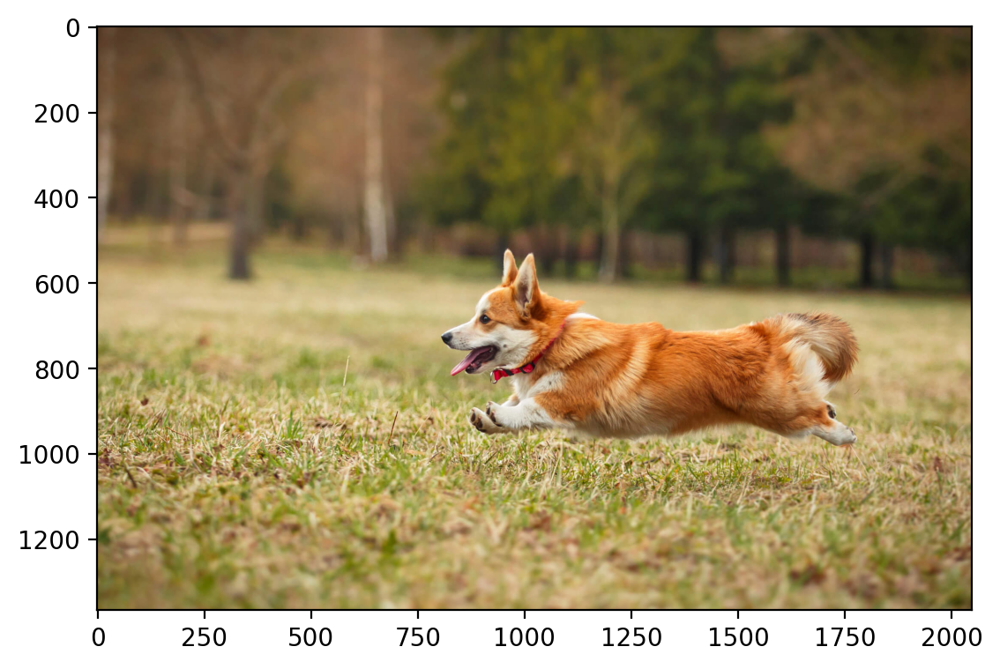

In [5]:
# image tensors are usually of shape (channels, height, width) --> (0,1,2)
# matplotlib expects (height, width, channels)
plt.imshow(img.permute(1,2,0).numpy().astype('uint8'))

In [6]:
# Extract patches surrounding the missing patch
def extract_patches(img,top_left,hight,width):
    x,y = top_left
    patches = torchvision.transforms.functional.crop(img,y,x,hight,width)
    return patches

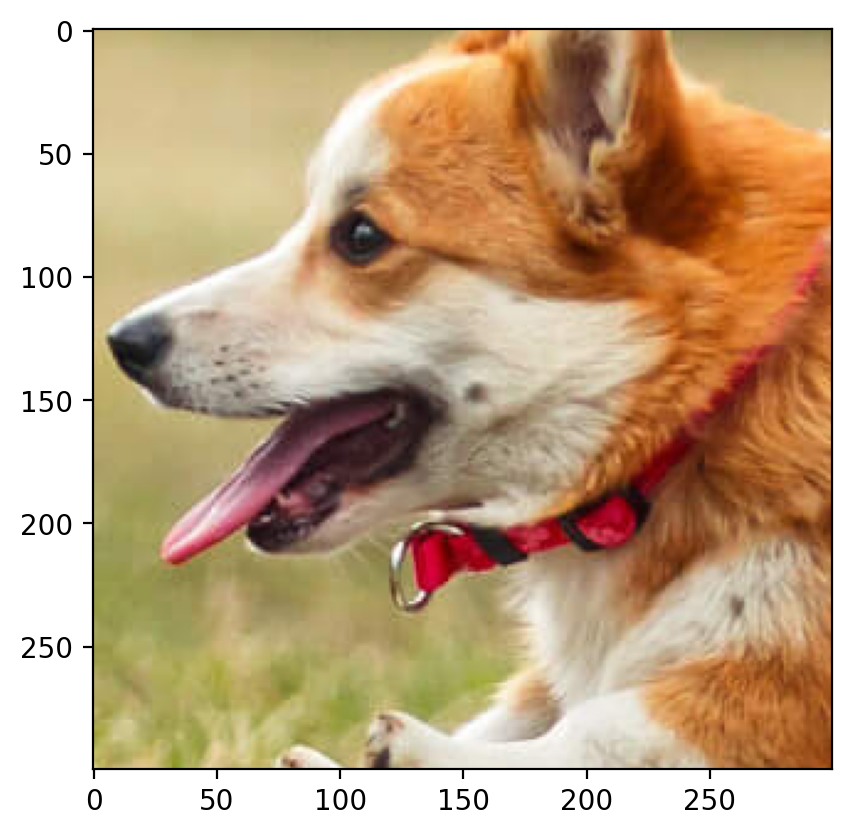

In [7]:
dog = extract_patches(img,(800,600),300,300)
plt.imshow(dog.permute(1,2,0).numpy().astype('uint8'))

In [8]:
def img_missing_patches(img,top_left,hight,width):
    y,x = top_left
    patches = extract_patches(img,top_left,hight,width)
    patches_copy = patches.clone().float()
    mask = torch.rand(patches.shape) <= 1
    patches_copy[mask] = float('nan')
    img_copy = img.clone().float()
    img_copy[:,x:x+width,y:y+hight] = patches_copy
    return img_copy,patches,patches_copy

In [9]:
# Define a function to factorize the matrix
def factorize(A, k,device=torch.device("cpu"), max_iter = 10000,convergence_threshold = 1e-6,lambda_reg=0.1):
    """Factorize the matrix A into two matrices W and H."""
    A = A.to(device)
    lst = []
    for i in range(3):
       
        # Randomly initialize matrices W and H
        W_r = torch.randn(A[i].shape[1], k, requires_grad=True, device=device)
        H_r = torch.randn(k, A[i].shape[1], requires_grad=True, device=device)
        # Adam optimizer
        optimizer = optim.Adam([W_r, H_r], lr=0.01)
        mask = ~torch.isnan(A[i])
        prev_loss = float('inf')
        for iteration in range(max_iter):
        
            # Compute the loss
            #print(torch.matmul(W_r, H_r).shape)
            diff_matrix = torch.matmul(W_r, H_r) - A[i]
            diff_vector = diff_matrix[mask]
            regularization = lambda_reg * (torch.norm(W_r) + torch.norm(H_r))
            loss = torch.norm(diff_vector)+ regularization

            if iteration > 0 and abs(prev_loss - loss.item()) < convergence_threshold:
                print(f'Converged after {iteration} iterations')
                break
            # Zero the gradients
            optimizer.zero_grad()
        
            # Backpropagate
            loss.backward()
        
            # Update the parameters
            optimizer.step()
            prev_loss = loss.item()
        
        lst.append(torch.clone(torch.matmul(W_r, H_r).detach()))
        #print(lst[i].shape)

    A_re = torch.stack([lst[0],lst[1],lst[2]], dim=0)
        
    #print(A_re)
    return A_re





In [10]:
dog[0].shape[0]

300

In [11]:
# Function to complete the missing patch
def complete_missing_patch(img, top_left, height, width, k,method="GD"):
    """Complete the missing rectangular patch in the image."""
    # Extract the patches surrounding the missing patch
    x, y = top_left
    img,patch,patch_copy = img_missing_patches(img,top_left,height,width)
    # Factorize the image matrix
    if(method=="GD"):
        img_re = factorize(img, k)
    # else:
    #     img_re = LS_factorize
    # Reconstruct the missing patch using factorized matrices
   
    
    
    return img,img_re,patch


In [12]:
import os
import matplotlib.pyplot as plt

def save_figure(patche,img, completed_img, name, folder="figures"):
    """Save the original and completed images as figures."""
    # Create the directory to store figures if it doesn't exist
    # if not os.path.exists(folder):
    #     os.makedirs(folder)

    # Plot both the original image and the completed image simultaneously
    plt.figure(figsize=(18, 6))  # Adjust the size as needed
    plt.subplot(1, 3, 1)
    plt.imshow((patche/255).permute(1, 2, 0).numpy())
    plt.title('Missing Patch')
    
    plt.subplot(1, 3, 2)
    plt.imshow((img/255).permute(1, 2, 0).numpy())
    plt.title('Original Image')

    plt.subplot(1, 3, 3)
    plt.imshow((completed_img/255).detach().permute(1, 2, 0).numpy())
    plt.title('Reconstructed Image')
   
    # Save the figure with the specified name in the folder
    plt.savefig(os.path.join(folder, f"{name}.png"))
    plt.show()
    plt.close()

# Example usage
# Assuming 'img' and 'completed_img' are the original and completed images, respectively
# and 'dog' is your image tensor
# img_const_LS(dog, (0,0), 30, 30, 70, 'Single_color_patch_missing')


In [13]:
def img_const(img,top_left,hight,width,k,name,method="GD"):
    img, re_img, patch = complete_missing_patch(img,top_left, hight, width, k)
    save_figure(patch,img, re_img, name)
    return img, re_img

### Image reconstruction with R

In [15]:
img,_,_ = img_missing_patches(dog,(0,0),30,30)
a=factorize(img, 50)
b=factorize(img, 200)

Converged after 3582 iterations
Converged after 4520 iterations
Converged after 4558 iterations
Converged after 1942 iterations
Converged after 1951 iterations


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
c:\Users\patel\AppData\Local\Programs\Python\Python311\Lib\site-packages\matplotlib\cm.py:496: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


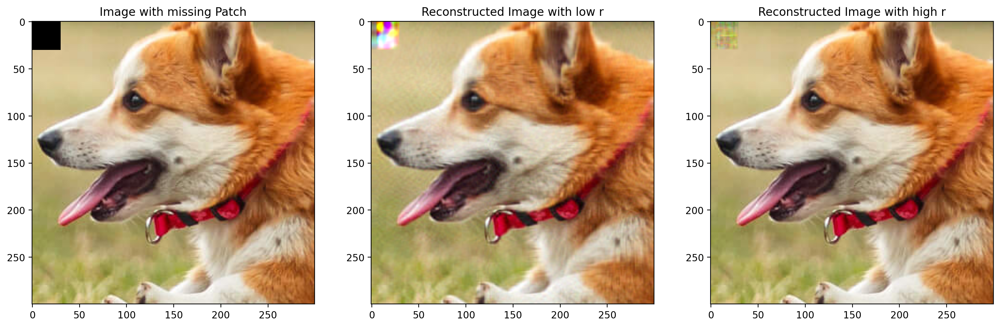

In [15]:
plt.figure(figsize=(18, 6))  # Adjust the size as needed
plt.subplot(1, 3, 1)
plt.imshow((img/255).permute(1, 2, 0).numpy())
plt.title('Image with missing Patch')

plt.subplot(1, 3, 2)
plt.imshow((a/255).permute(1, 2, 0).numpy())
plt.title('Reconstructed Image with low r')

plt.subplot(1, 3, 3)
plt.imshow((b/255).detach().permute(1, 2, 0).numpy())
plt.title('Reconstructed Image with high r')

plt.show()
plt.close()

In [19]:
print("RMSE",rmse(b.numpy(),dog.numpy()))
print("PSNR",psnr(b.numpy(),dog.numpy()))

RMSE 2.808305
PSNR 39.194605350494385


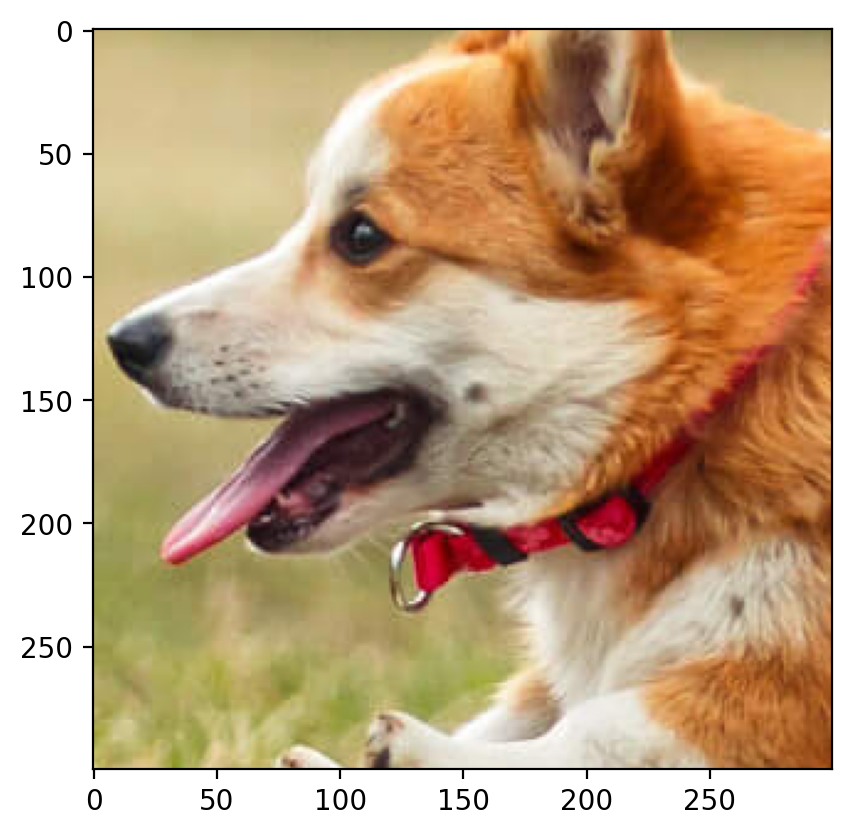

In [16]:
plt.imshow(dog.permute(1,2,0).numpy().astype('uint8'))

In [20]:
def mask_image(img, width, height):
    img_copy = img.clone().float()
    shape = img.shape
    
    # Generate random indices for masking
    mask_indices = torch.randperm(shape[1] * shape[2])[:width * height]
    
    # Convert indices to 2D coordinates
    mask_indices_2d = torch.unravel_index(mask_indices, (shape[1], shape[2]))
    
    # Create a mask
    mask = torch.zeros((shape[1], shape[2]), dtype=torch.bool)
    mask[mask_indices_2d] = True
    
    # Apply the mask to the image
    for i in range(shape[0]):
        img_copy[i][mask] = float('nan')
    
    return img_copy, mask


In [21]:
masked_img = mask_image(dog, 30,30)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


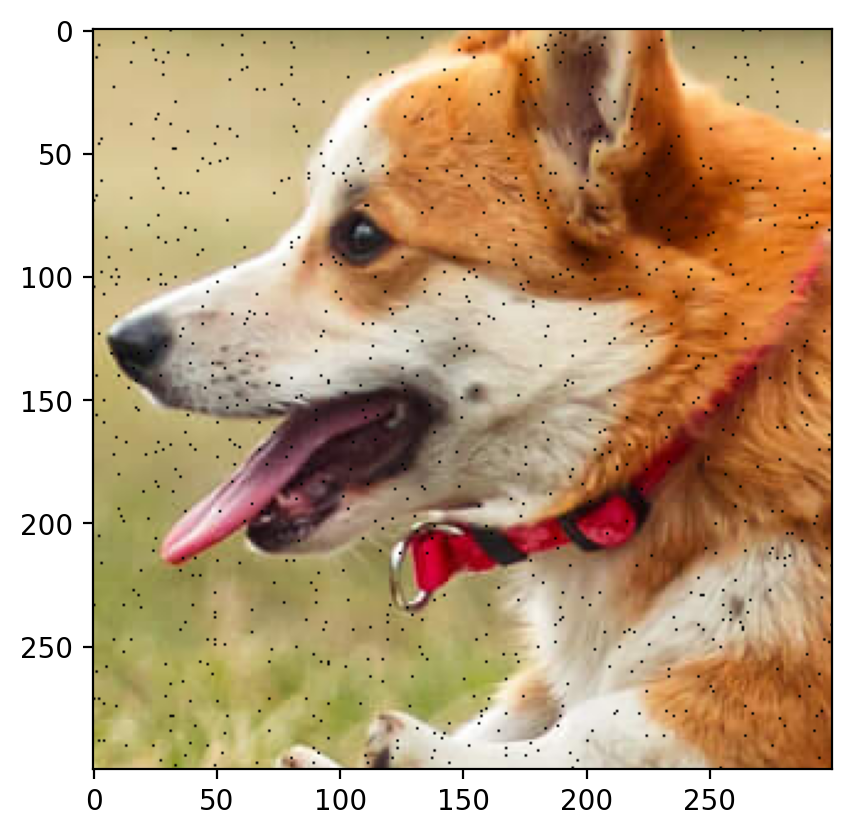

In [22]:
# Ploting masked image with randomly removed pixels
plt.imshow(masked_img[0].permute(1,2,0).int().numpy())

Converged after 3012 iterations
Converged after 2730 iterations


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Converged after 2865 iterations


c:\Users\patel\AppData\Local\Programs\Python\Python311\Lib\site-packages\matplotlib\cm.py:496: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


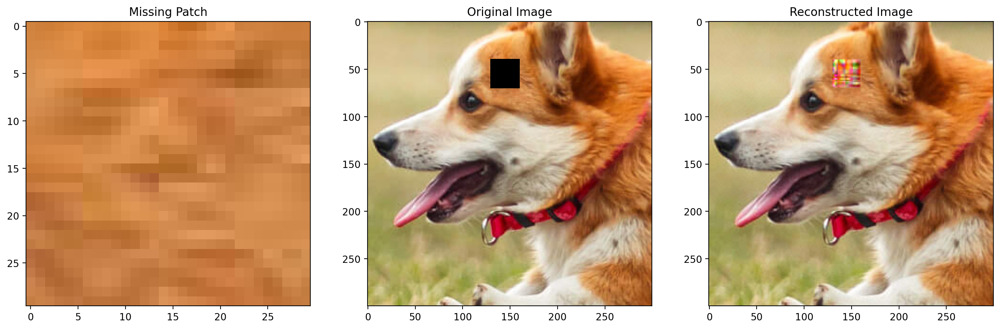

In [23]:
# Reconstruction of image with rectangular patch removed
_,re_img_rect_patch=img_const(dog,(130,40),30,30,100, "Part 1 missing 30x30 Patch")

In [25]:
img_rand_patch_re=factorize(masked_img[0],100)

Converged after 2923 iterations
Converged after 2675 iterations
Converged after 2544 iterations


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


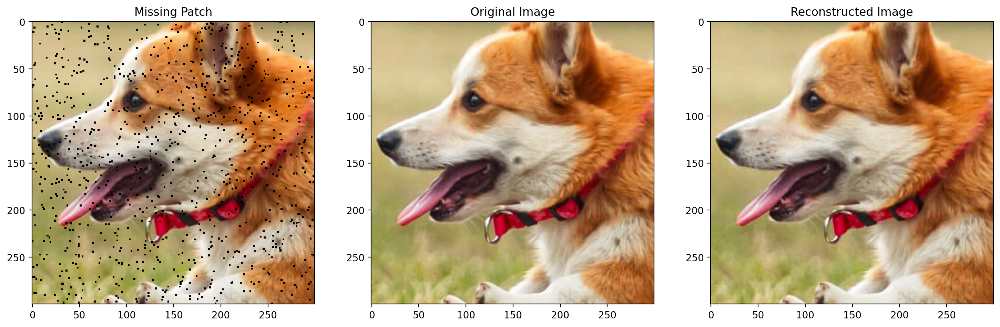

In [26]:
save_figure(masked_img[0],dog,img_rand_patch_re,"Randomly removed patchs reconstruction")

In [28]:
print("RMSE",rmse(img_rand_patch_re.numpy(),dog.numpy()))
print("PSNR",psnr(img_rand_patch_re.numpy(),dog.numpy()))

RMSE 1.6126378
PSNR 44.16801452636719


### Metric

In [16]:
# RMSE
def rmse(re_img, original_img):
    mse=np.mean(np.square(re_img-original_img))
    return np.sqrt(mse)

# Peak signal to noise ratio
def psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr


In [24]:
rmse_rect_patch_img=rmse(re_img_rect_patch.numpy(),dog.numpy())
rmse_rand_patch_img=rmse(img_rand_patch_re.numpy(),dog.numpy())
psnr_rect_patch_img=psnr(re_img_rect_patch.numpy(),dog.numpy())
psnr_rand_patch_img=psnr(img_rand_patch_re.numpy(),dog.numpy())
print("RMSE of reconstructon of rect patch removed img ",rmse_rect_patch_img)
print("RMSE of reconstructon of randomly pixels removed img ",rmse_rand_patch_img)

print("\nPSNR of reconstructon of rect patches removed img ",psnr_rect_patch_img)
print("PSNR of reconstructon of randomly pixels removed img ",psnr_rand_patch_img)

RMSE of reconstructon of rect patch removed img  5.3903813
RMSE of reconstructon of randomly pixels removed img  1.6113578

PSNR of reconstructon of rect patches removed img  36.46384239196777
PSNR of reconstructon of randomly pixels removed img  44.169859886169434


### Part 2
Vary region size (NxN) for ```N = [20, 40, 60, 80]``` and perform Gradient Descent till convergence. Again, consider the two cases for your region as mentioned in Part (a). Demonstrate the variation in reconstruction quality by making appropriate plots and metrics. **[2 Marks]**

Converged after 3082 iterations
Converged after 2486 iterations


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Converged after 3065 iterations


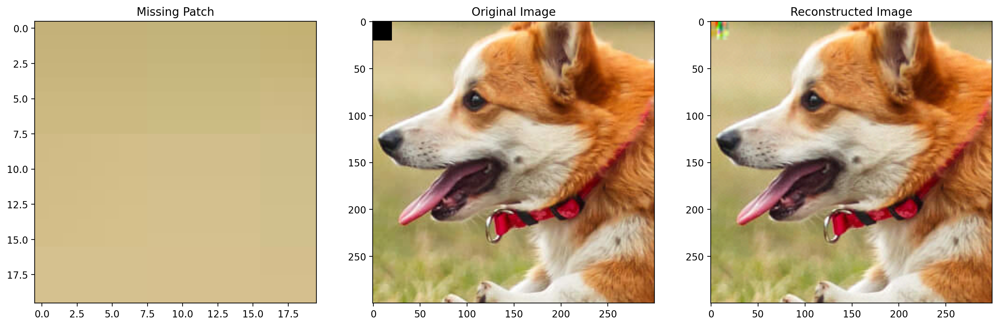

Converged after 3219 iterations
Converged after 3020 iterations


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Converged after 3670 iterations


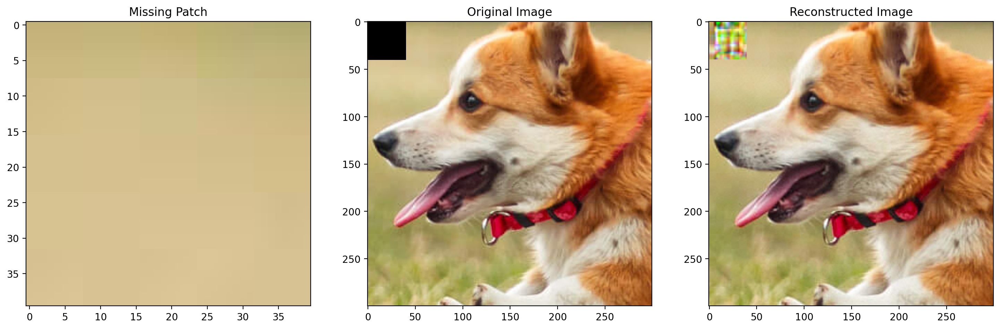

Converged after 4017 iterations
Converged after 6478 iterations


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Converged after 3906 iterations


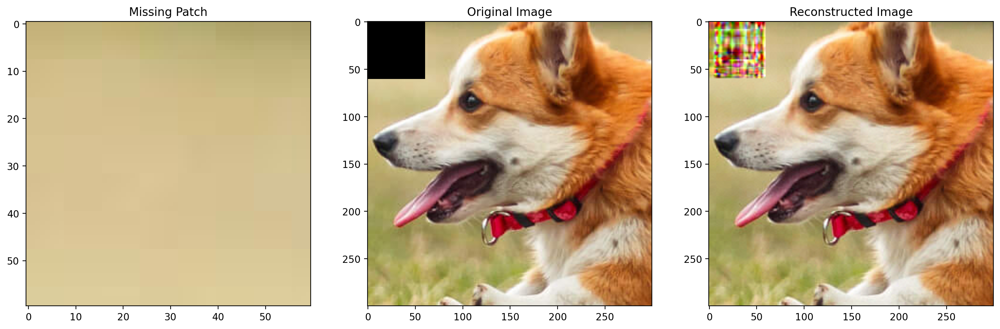

Converged after 6435 iterations
Converged after 6353 iterations


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Converged after 2386 iterations


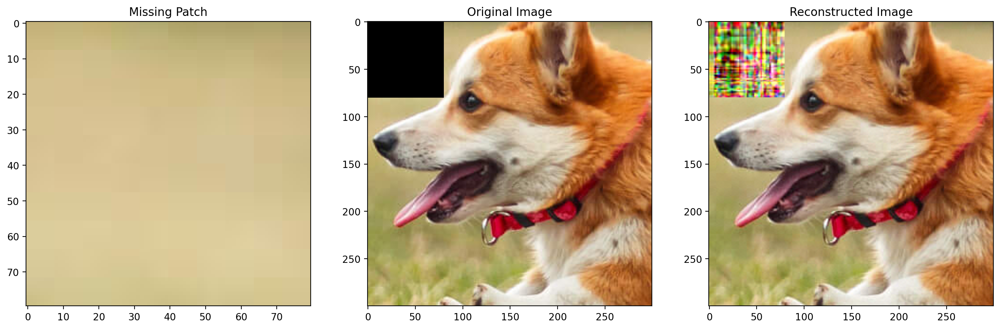

In [25]:
# Reconstruction of image with rectangular patch removed
top_left=(0,0)
height=30
width=30
_,img_rect_patch_re20x20=img_const(dog,top_left,20,20,100, "Part 1 missing 20x20 Patch")
_,img_rect_patch_re40x40=img_const(dog,top_left,40,40,100, "Part 1 missing 40x40 Patch")
_,img_rect_patch_re60x60=img_const(dog,top_left,60,60,100, "Part 1 missing 60x60 Patch")
_,img_rect_patch_re80x80=img_const(dog,top_left,80,80,100, "Part 1 missing 80x80 Patch")


In [26]:
rmse_rect_patch_img20x20=rmse(img_rect_patch_re20x20.numpy(),dog.numpy())
rmse_rect_patch_img40x40=rmse(img_rect_patch_re40x40.numpy(),dog.numpy())
rmse_rect_patch_img60x60=rmse(img_rect_patch_re60x60.numpy(),dog.numpy())
rmse_rect_patch_img80x80=rmse(img_rect_patch_re80x80.numpy(),dog.numpy())

psnr_rect_patch_img20x20=psnr(img_rect_patch_re20x20.numpy(),dog.numpy())
psnr_rect_patch_img40x40=psnr(img_rect_patch_re40x40.numpy(),dog.numpy())
psnr_rect_patch_img60x60=psnr(img_rect_patch_re60x60.numpy(),dog.numpy())
psnr_rect_patch_img80x80=psnr(img_rect_patch_re80x80.numpy(),dog.numpy())


In [27]:
rand_masked_img20x20 = mask_image(dog, 20,20)
rand_masked_img40x40 = mask_image(dog, 40,40)
rand_masked_img60x60 = mask_image(dog, 60,60)
rand_masked_img80x80 = mask_image(dog, 80,80)

img_rand_patch_re20x20=factorize(rand_masked_img20x20[0],100)
img_rand_patch_re40x40=factorize(rand_masked_img40x40[0],100)
img_rand_patch_re60x60=factorize(rand_masked_img60x60[0],100)
img_rand_patch_re80x80=factorize(rand_masked_img80x80[0],100)

Converged after 2855 iterations
Converged after 2578 iterations
Converged after 2383 iterations
Converged after 5710 iterations
Converged after 2665 iterations
Converged after 2488 iterations
Converged after 2877 iterations
Converged after 2724 iterations
Converged after 2458 iterations
Converged after 5449 iterations
Converged after 2366 iterations
Converged after 2736 iterations


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


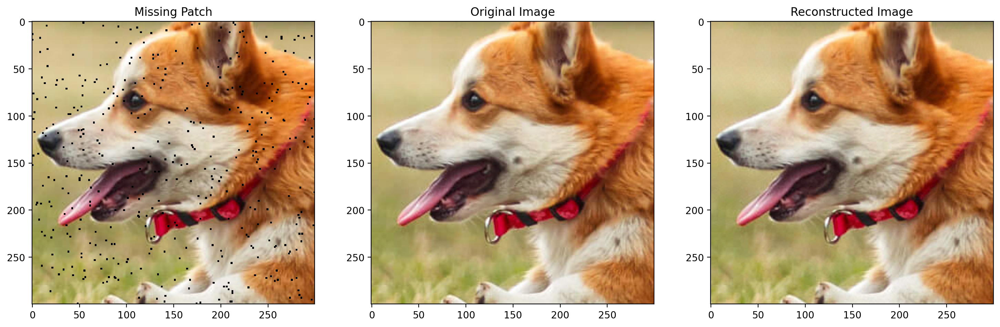

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


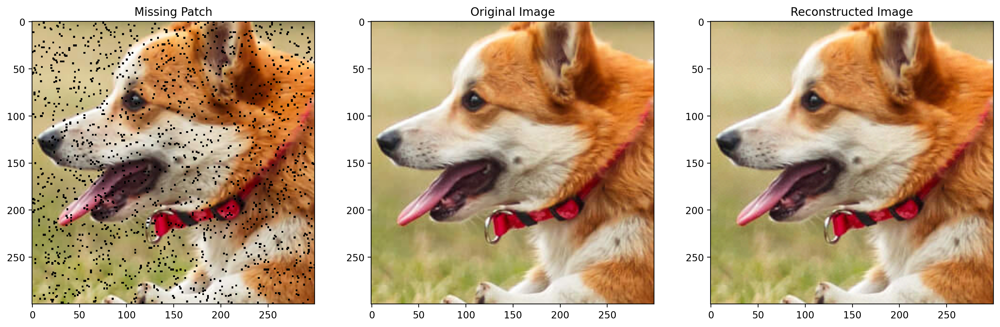

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


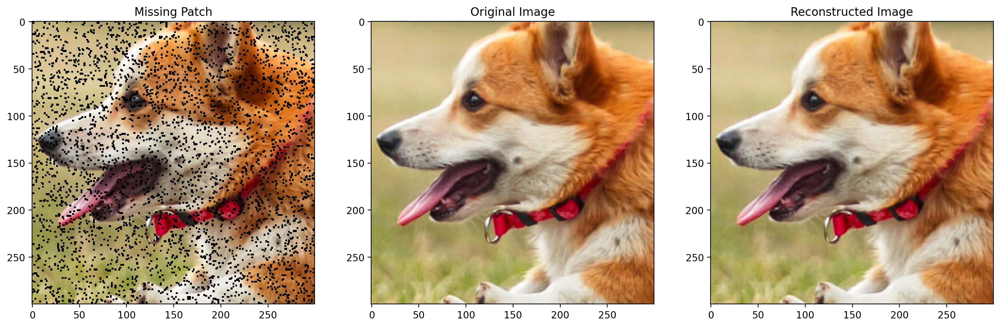

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


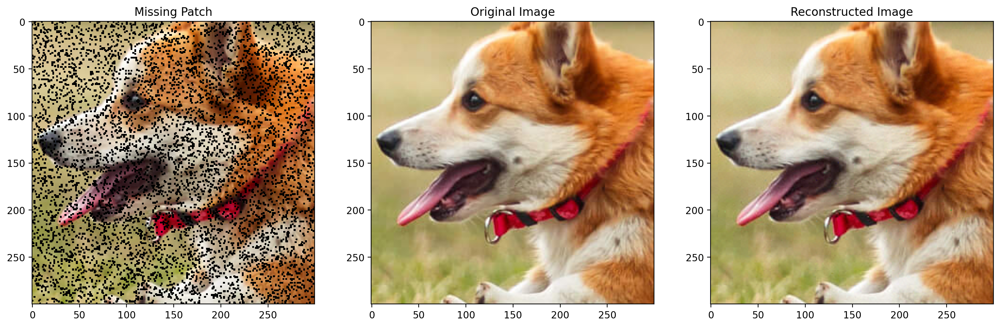

In [28]:
save_figure(rand_masked_img20x20[0],dog,img_rand_patch_re20x20,"Randomly removed 20x20 pixels reconstruction")
save_figure(rand_masked_img40x40[0],dog,img_rand_patch_re40x40,"Randomly removed 40x40 pixels reconstruction")
save_figure(rand_masked_img60x60[0],dog,img_rand_patch_re60x60,"Randomly removed 60x60 pixels reconstruction")
save_figure(rand_masked_img80x80[0],dog,img_rand_patch_re80x80,"Randomly removed 80x80 pixels reconstruction")

In [29]:
rmse_rand_patch_img20x20=rmse(img_rand_patch_re20x20.numpy(),dog.numpy())
rmse_rand_patch_img40x40=rmse(img_rand_patch_re40x40.numpy(),dog.numpy())
rmse_rand_patch_img60x60=rmse(img_rand_patch_re60x60.numpy(),dog.numpy())
rmse_rand_patch_img80x80=rmse(img_rand_patch_re80x80.numpy(),dog.numpy())

psnr_rand_patch_img20x20=psnr(img_rand_patch_re20x20.numpy(),dog.numpy())
psnr_rand_patch_img40x40=psnr(img_rand_patch_re40x40.numpy(),dog.numpy())
psnr_rand_patch_img60x60=psnr(img_rand_patch_re60x60.numpy(),dog.numpy())
psnr_rand_patch_img80x80=psnr(img_rand_patch_re80x80.numpy(),dog.numpy())

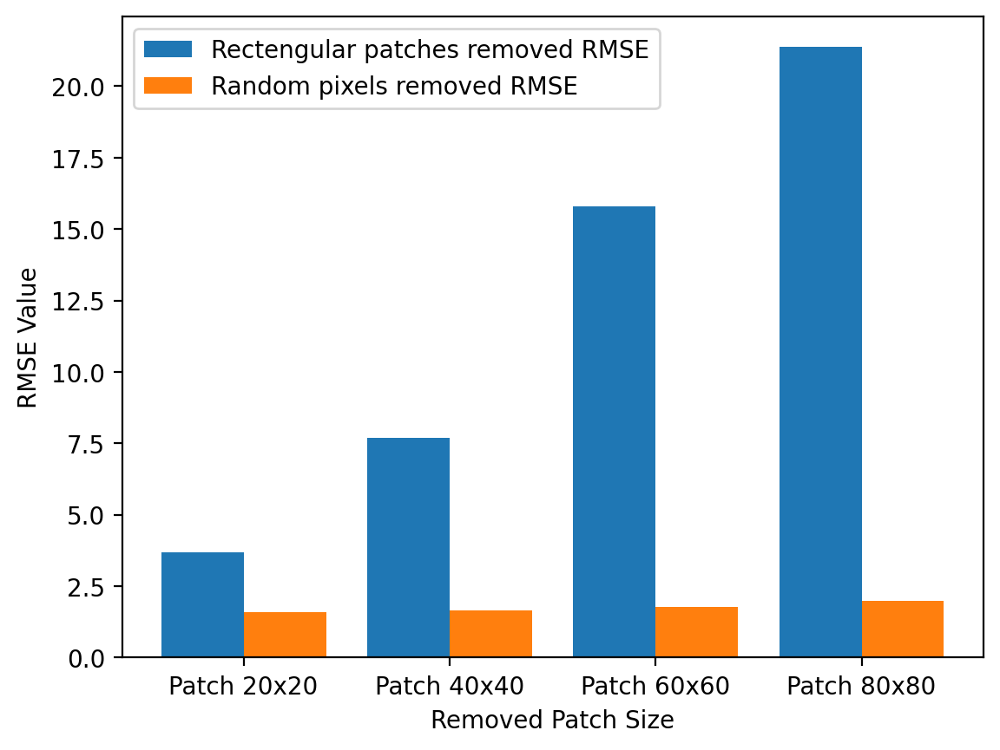

In [30]:
X=["Patch 20x20","Patch 40x40","Patch 60x60","Patch 80x80"]
Y1_rmse=[rmse_rect_patch_img20x20,rmse_rect_patch_img40x40,rmse_rect_patch_img60x60,rmse_rect_patch_img80x80]
Y2_rmse=[rmse_rand_patch_img20x20,rmse_rand_patch_img40x40,rmse_rand_patch_img60x60,rmse_rand_patch_img80x80]
plt.bar(np.arange(len(X))-0.2, Y1_rmse, 0.4,label="Rectengular patches removed RMSE")
plt.bar(np.arange(len(X))+0.2, Y2_rmse, 0.4,label="Random pixels removed RMSE")
plt.xticks(np.arange(len(X)),X)
plt.legend()
plt.xlabel("Removed Patch Size")
plt.ylabel("RMSE Value")
plt.show()


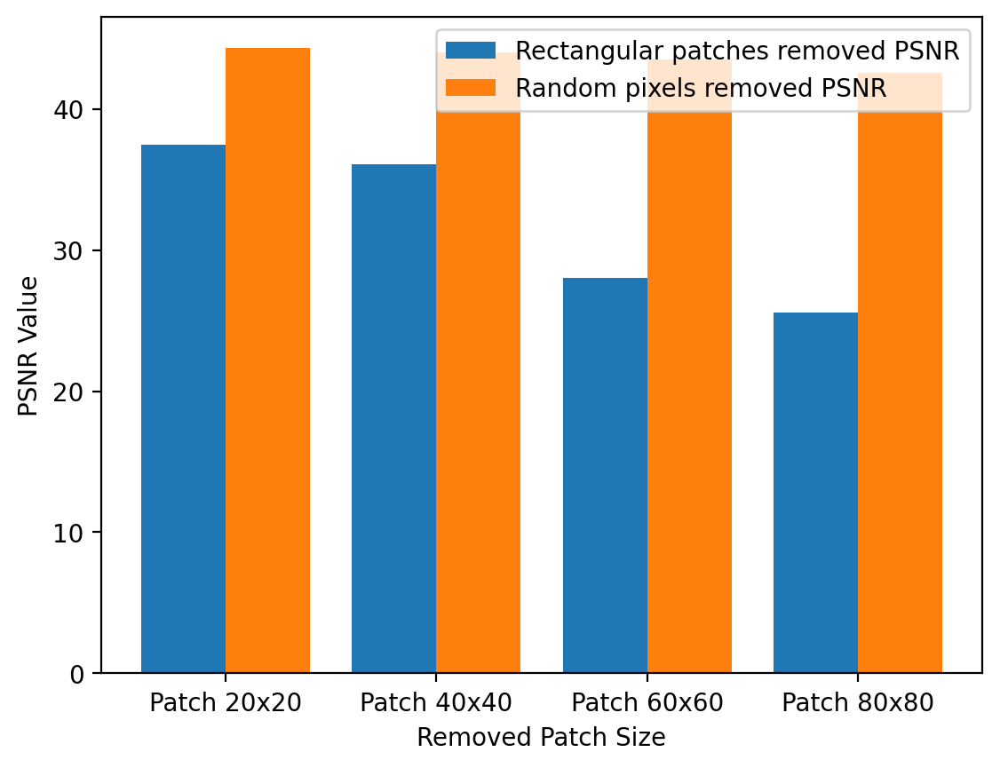

In [31]:
Y1_psnr=[psnr_rect_patch_img20x20, psnr_rect_patch_img40x40, psnr_rect_patch_img60x60, psnr_rect_patch_img80x80]
Y2_psnr=[psnr_rand_patch_img20x20, psnr_rand_patch_img40x40, psnr_rand_patch_img60x60, psnr_rand_patch_img80x80]
plt.bar(np.arange(len(X))-0.2, Y1_psnr, 0.4,label="Rectangular patches removed PSNR")
plt.bar(np.arange(len(X))+0.2, Y2_psnr, 0.4,label="Random pixels removed PSNR")
plt.xticks(np.arange(len(X)),X)
plt.legend()
plt.xlabel("Removed Patch Size")
plt.ylabel("PSNR Value")
plt.show()